# A tutorial for performing differential (aperture) photometry with python

Begin by reading in relevant packages

In [49]:
%pylab inline
#from pathlib import Path
from astropy.io import fits
from astropy import units as u
from astropy.nddata import CCDData
import ccdproc as ccdp
from ccdproc import trim_image
from ccdproc import subtract_overscan
import os
from astropy.nddata import CCDData
from skimage.feature import register_translation
import pickle as pickle
from photutils import DAOStarFinder
from astropy.stats import sigma_clipped_stats
from photutils import CircularAperture, CircularAnnulus, aperture_photometry
import imexam
from astropy.time import Time
import pandas as pd

Populating the interactive namespace from numpy and matplotlib


/Users/csalyk/anaconda/lib/python3.5/site-packages/IPython/core/magics/pylab.py:160: UserWarning: pylab import has clobbered these variables: ['time']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


Define data directories.  *You will need to replace these with appropriate directories on your computer*.

In [9]:
raw_dir='/Users/csalyk/mypy/phot_tutorial/data/raw/'  #Replace!
overscan_dir='/Users/csalyk/mypy/phot_tutorial/data/overscan_sub/' #Replace!
reduced_dir='/Users/csalyk/mypy/phot_tutorial/data/reduced/' #Replace!

## Begin by locating source in image

The observed source is WASP-2b.  *Begin this work by using SIMBAD's Aladin applet to locate WASP-2b in this image.*  If you'd like to mark its position for future reference, enter its position below and plot it.

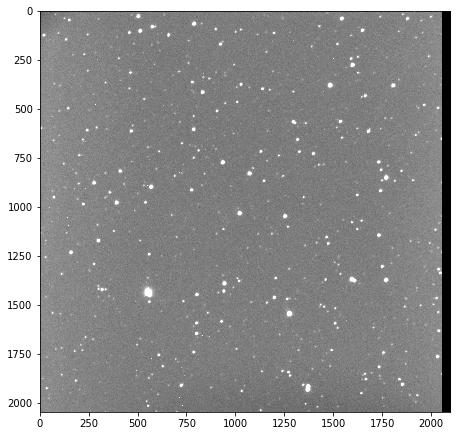

In [10]:
presub_file=raw_dir+'16s22-001v.fit'  #One input file. 
presub_hdul = fits.open(presub_file)   #Read in pre-subtraction image
presub_img = presub_hdul[0].data

#source_position=[x,y] #replace x and y by position of source to mark 

fig=plt.figure(figsize=(25,12))
ax1=fig.add_subplot(131)
ax1.imshow(presub_img, cmap='gray',vmin=np.median(presub_img)*0.7, vmax=np.median(presub_img)*1.3)
#ax1.plot(source_position[0],source_position[1],'r+')  #uncomment to show cross

## Perform overscan subtraction

First define function to perform overscan subtraction.

In [11]:
def overscan_subtraction(infiles, outdir):
    if(not outdir.endswith('/')): outdir=outdir+'/'
    if(not os.path.exists(outdir)): os.mkdir(outdir)
    
    #Scan inbox directory for .fit files
    for image in infiles:
        outfile=outdir+os.path.split(image)[1]  #Define output file
        print('Processing image '+image)
           
        #Generate a CCDData object from the image's data array
        hdul = fits.open(image)
        ccddata = CCDData(hdul[0].data, unit=u.adu)

        #subtract overscan row-by-row and crop region
        overscan_subtracted_data = subtract_overscan(ccddata, overscan=ccddata[:, 2049:2096])
        overscan_subtracted_trimmed_data = np.asarray(trim_image(overscan_subtracted_data[:, :2048]))
            
        #Update header information for image width
        header = hdul[0].header
        header['NAXIS1'] = 2048
        header['IMAGEW'] = 2048
    
        #Save data to outbox directory.
        hdul[0].data = overscan_subtracted_trimmed_data
        hdul.writeto(outfile)

Then, define input files and output directory and run overscan subtraction on all images.  *You will need to replace the directories with appropriate directories on your machine!*

In [15]:
#Create the list of input files
indir='/Users/csalyk/mypy/phot_tutorial/data/raw/'  #Replace!
filelist=[]
for file in os.listdir(indir):
    if (file.endswith("z.fit") or file.endswith("d.fit") or file.endswith("v.fit")): #Excludes flats
        filelist.append(os.path.join(indir, file))

#Define the output directory
outdir='/Users/csalyk/mypy/phot_tutorial/data/overscan_sub'
#print(filelist)  #Run this command to check your list of files

Then use function to do overscan subtraction on all images

In [16]:
#Run overscan subtraction on filelist
overscan_subtraction(filelist, outdir)

Processing image /Users/csalyk/mypy/phot_tutorial/data/raw/16s22-001d.fit
Processing image /Users/csalyk/mypy/phot_tutorial/data/raw/16s22-001v.fit
Processing image /Users/csalyk/mypy/phot_tutorial/data/raw/16s22-001z.fit
Processing image /Users/csalyk/mypy/phot_tutorial/data/raw/16s22-002d.fit
Processing image /Users/csalyk/mypy/phot_tutorial/data/raw/16s22-002v.fit
Processing image /Users/csalyk/mypy/phot_tutorial/data/raw/16s22-002z.fit
Processing image /Users/csalyk/mypy/phot_tutorial/data/raw/16s22-003d.fit
Processing image /Users/csalyk/mypy/phot_tutorial/data/raw/16s22-003v.fit
Processing image /Users/csalyk/mypy/phot_tutorial/data/raw/16s22-003z.fit
Processing image /Users/csalyk/mypy/phot_tutorial/data/raw/16s22-004d.fit
Processing image /Users/csalyk/mypy/phot_tutorial/data/raw/16s22-004v.fit
Processing image /Users/csalyk/mypy/phot_tutorial/data/raw/16s22-004z.fit
Processing image /Users/csalyk/mypy/phot_tutorial/data/raw/16s22-005d.fit
Processing image /Users/csalyk/mypy/ph

At this point, you may want to check your overscan_sub directory to make sure the images have been correctly output there.

Now let's do a visual inspection to make sure the routine worked as expected

Shapes of images:  (2048, 2096) (2048, 2048)
Mean values in images: 2864.612036552138 1377.9597238530512


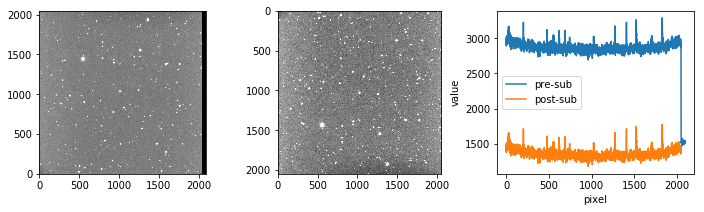

In [17]:
presub_file=raw_dir+'16s22-001v.fit'  #One input file
postsub_file=overscan_dir+'16s22-001v.fit' #One output file
presub_hdul = fits.open(presub_file)   #Read in pre-subtraction image
postsub_hdul = fits.open(postsub_file) #Read in post-subtraction image
presub_img = presub_hdul[0].data
postsub_img = postsub_hdul[0].data

fig=plt.figure(figsize=(12,3))
#Plot pre-sub image
ax1=fig.add_subplot(131)
ax1.imshow(presub_img, cmap='gray',vmin=np.median(presub_img)*0.7, vmax=np.median(presub_img)*1.3,origin='lower')
#Plot post-sub image
ax2=fig.add_subplot(132)
ax2.imshow(postsub_img, cmap='gray',vmin=np.median(postsub_img)*0.7, vmax=np.median(postsub_img)*1.3)
#Plot one row of each image, to compare
ax3=fig.add_subplot(133)
ax3.plot(presub_img[1250,:],label='pre-sub')
ax3.plot(postsub_img[1250,:],label='post-sub')
ax3.legend()
ax3.set_xlabel('pixel')
ax3.set_ylabel('value')

print('Shapes of images: ',np.shape(presub_img),np.shape(postsub_img))
print('Mean values in images:', np.mean(presub_img),np.mean(postsub_img))

## Create a master bias

Collect bias frames and produce an average 'master' bias

In [18]:
#Define the list of bias images
overscan_biases = ccdp.ImageFileCollection(overscan_dir,glob_include='*z.fit') 
#Print out basic info about images to make sure you got the right ones
overscan_biases.summary['file', 'imagetyp', 'exptime', 'naxis1', 'naxis2']
overscan_bias_files = overscan_biases.files_filtered(include_path=True)
#Combine bias frames together by averaging. Save to "master_bias.fit"
combined_bias = ccdp.combine(overscan_bias_files, unit='adu',
                             output_file=overscan_dir+'master_bias.fit',overwrite=True)

Inspect master bias

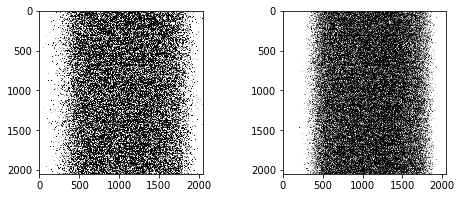

In [19]:
masterbias_file=overscan_dir+'master_bias.fit' 
masterbias_hdul = fits.open(masterbias_file)   #Read in bias image
masterbias_img = masterbias_hdul[0].data

bias_hdul = fits.open(overscan_bias_files[0])
bias_img = bias_hdul[0].data

fig=plt.figure(figsize=(8,3))
#Plot bias image
ax1=fig.add_subplot(121)
ax1.imshow(bias_img, cmap='gray',vmin=np.median(bias_img)*0.7, vmax=np.median(bias_img)*1.3)
ax2=fig.add_subplot(122)
ax2.imshow(masterbias_img, cmap='gray',vmin=np.median(bias_img)*0.7, vmax=np.median(bias_img)*1.3)

## Create a master dark

First inspect exposure times to decide on strategy.

Option 1: Average all dark frames with same exposure time as science frames.

Option 2: Subtract bias from all dark frames, then scale by exposure time for each science frame.

In [20]:
#Inspect all images to look at exposure times of science and dark frames
all_images = ccdp.ImageFileCollection(overscan_dir)
all_images.summary['file','imagetyp','exptime'].show_in_notebook()
#Since dark frames mostly had 75s exposure, like science frames, I'll extract only those
#(i.e., I'm going with option 1)

idx,file,imagetyp,exptime
0,16s22-001d.fit,Dark Frame,75.0
1,16s22-001v.fit,Light Frame,75.0
2,16s22-001z.fit,Bias Frame,0.0
3,16s22-002d.fit,Dark Frame,75.0
4,16s22-002v.fit,Light Frame,75.0
5,16s22-002z.fit,Bias Frame,0.0
6,16s22-003d.fit,Dark Frame,75.0
7,16s22-003v.fit,Light Frame,75.0
8,16s22-003z.fit,Bias Frame,0.0
9,16s22-004d.fit,Dark Frame,75.0


Option 1

In [21]:
#Collect dark images
dark_images=ccdp.ImageFileCollection(overscan_dir,glob_include='*d.fit')
#Limit ourselves to darks with 75s exposure times
dark_75s_files = dark_images.files_filtered(exptime=75.0,include_path=True)
#Combine into a master dark
combined_dark_75s = ccdp.combine(dark_75s_files, unit='adu',
                             output_file=overscan_dir+'master_dark_75s.fit')

## Create a master flat

In our case, our flat is already constructed.  Let's inspect the flat to make sure it's reasonable.  Look carefully to see dust "donuts".

(2048, 2048)


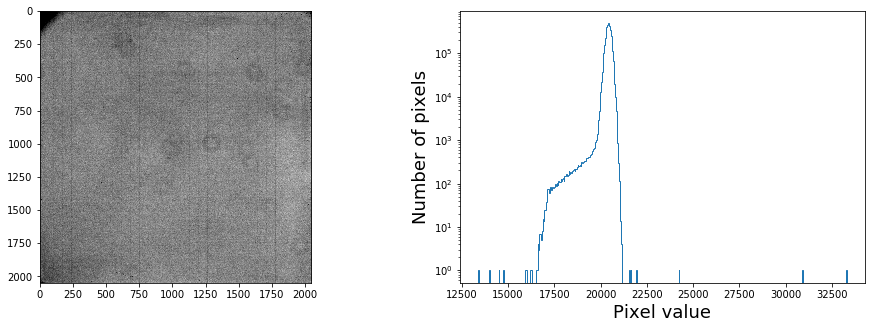

In [22]:
vflat_file=raw_dir+'VFLAT.fit'
vflat_hdul = fits.open(vflat_file)   #Read in pre-subtraction image
vflat_img = vflat_hdul[0].data

fig=plt.figure(figsize=(16,5))
#Plot image
ax1=fig.add_subplot(121)
ax1.imshow(vflat_img, cmap='gray',vmin=np.median(vflat_img)*0.95, vmax=np.median(vflat_img)*1.05)

ax2=fig.add_subplot(122)
ax2.hist(vflat_img.flatten(),histtype='step',bins=500)
ax2.set_yscale('log')
ax2.set_xlabel('Pixel value',fontsize=18)
ax2.set_ylabel('Number of pixels',fontsize=18)

#Print out shape of image to make sure it's been overscan-subtracted
print(np.shape(vflat_img))

## "Reduce" data files (perform bias and dark subtraction, division by flat)

Let's do one image to test the procedure

In [25]:
science_ifc=ccdp.ImageFileCollection(overscan_dir,glob_include='*v.fit')
science_files = science_ifc.files_filtered(include_path=True)
science_ccd1=CCDData.read(science_files[0], unit="adu") 

master_dark_75s_ccd=CCDData.read(overscan_dir+'master_dark_75s.fit', unit="adu")

vflat_ccd=CCDData.read(raw_dir+'VFLAT.fit', unit="adu")

#Subtract the dark from the science image
reduced_ccd1 = ccdp.subtract_dark(science_ccd1, master_dark_75s_ccd,
                              exposure_time='EXPTIME', #Name of exposure time in header
                              exposure_unit=u.second)

#Divide the dark-subtracted science image by the flat
reduced_ccd1 = ccdp.flat_correct(reduced_ccd1, vflat_ccd)

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


Now output the resulting image, to make sure it's sensible.

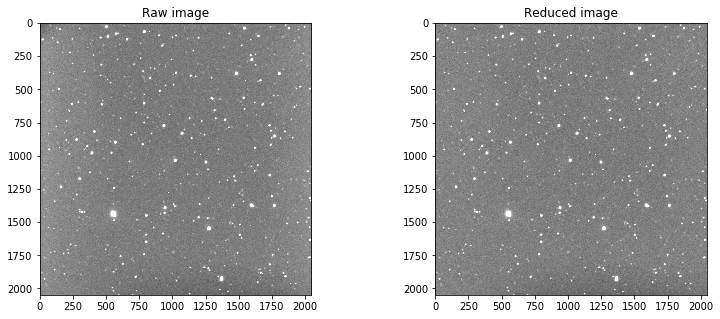

In [26]:
fig=plt.figure(figsize=(13,5))
#Plot image
ax1=fig.add_subplot(121)
ax1.set_title('Raw image')
ax1.imshow(science_ccd1.data, cmap='gray',vmin=np.median(science_ccd1.data)*0.5, 
           vmax=np.median(science_ccd1.data)*1.5)

ax2=fig.add_subplot(122)
ax2.set_title('Reduced image')
ax2.imshow(reduced_ccd1.data, cmap='gray',vmin=np.median(reduced_ccd1.data)*0.5, 
           vmax=np.median(reduced_ccd1.data)*1.5)

Now we'll turn this into a loop over all images

In [27]:
#Define list of science images from overscan
science_ifc=ccdp.ImageFileCollection(overscan_dir,glob_include='*v.fit')
science_files = science_ifc.files_filtered()

#Define master dark and master flat images
master_dark_75s_ccd=CCDData.read(overscan_dir+'master_dark_75s.fit', unit="adu")
vflat_ccd=CCDData.read(raw_dir+'VFLAT.fit', unit="adu")

#Loop through all science files.  Subtract dark and divide by flat.
for i, myfile in enumerate(science_files):
    science_ccd=CCDData.read(overscan_dir+myfile, unit="adu") 
 
    #Subtract the dark from the science image
    reduced_ccd = ccdp.subtract_dark(science_ccd, master_dark_75s_ccd,
                                      exposure_time='EXPTIME', #Name of exposure time in header
                                      exposure_unit=u.second)

    #Divide the dark-subtracted science image by the flat
    reduced_ccd = ccdp.flat_correct(reduced_ccd, vflat_ccd)

    #Write file out
    outfile=reduced_dir+myfile
    print("Writing reduced image data to:",outfile)
    reduced_ccd.write(outfile)

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
Writing reduced image data to: /Users/csalyk/mypy/phot_tutorial/data/reduced/16s22-001v.fit
Writing reduced image data to: /Users/csalyk/mypy/phot_tutorial/data/reduced/16s22-002v.fit
Writing reduced image data to: /Users/csalyk/mypy/phot_tutorial/data/reduced/16s22-003v.fit
Writing reduced image data to: /Users/csalyk/mypy/phot_tutorial/data/reduced/16s22-004v.fit
Writing reduced image data to: /Users/csalyk/mypy/phot_tutorial/data/reduced/16s22-005v.fit
Writing reduced image data to: /Users/csalyk/mypy/phot_tutorial/data/reduced/16s22-006v.fit
Writing reduced image data to: /Users/csalyk/mypy/phot_tutorial/data/reduced/16s22-007v.fit
Writing reduced image data to: /Users/csalyk/mypy/phot_tutorial/data/reduced/16s22-009v.fit
Writing reduced image data to: /Users/csalyk/mypy/phot_tutorial/data/reduced/16s22-010v.fit
Writing reduced image data to: /Users/csalyk/mypy/phot

Writing reduced image data to: /Users/csalyk/mypy/phot_tutorial/data/reduced/16s22-092v.fit


At this point, it would be good to check that your files were correctly written to the "reduced" directory. 

## Find and store image shifts

Warning!!! Next line of code may take a while to run, and use a lot of processor.  Once you've run it once, comment it out so you don't accidentally run it again.  Your data will all be stored in a file once you've run this once.

This code will read in all reduced files and figure out how much they're shifted relative to the first file.  They'll save these shifts to a file, so they can be retrieved later.

In [120]:
#Read in all files in *reduced* image directory
science_ifc=ccdp.ImageFileCollection(reduced_dir,glob_include='*v.fit')
science_files = science_ifc.files_filtered(include_path=False)

## choose an image to define as zero shift:
science_ccd1=CCDData.read(reduced_dir+science_files[0], unit="adu") 
zero_shift_data = science_ccd1.data

imshifts = {} # dictionary to hold the x and y shift pairs for each image
#Loop through all science files.  Compute x and y shift for each image

#These lines of code have been commented out, so you don't run them until you're sure you want to.  
#You only have to run them once, as long as you make sure not to delete the image_shifts.p file.
#for i, myfile in enumerate(science_files):
#    science_ccd=CCDData.read(reduced_dir+myfile, unit="adu") 
#    data=science_ccd.data
    ## register_translation is a function that calculates shifts by comparing 2-D arrays
#    result, error, diffphase = register_translation(zero_shift_data, data, 1000)
#    imshifts[myfile] = result

#pickle.dump( imshifts, open(reduced_dir+"image_shifts.p", "wb" ))  #Write image shifts to file

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


## Define apertures for photometry

Find locations of stars using DAOFind.  We only have to do this for one image, since we know how much the stars are shifted in other images.

In [28]:
#Get some stats about images
science_ifc=ccdp.ImageFileCollection(reduced_dir,glob_include='*v.fit')
science_files = science_ifc.files_filtered()
science_ccd1=CCDData.read(reduced_dir+science_files[0], unit="adu") 
data=science_ccd1.data
mean, median, std = sigma_clipped_stats(data, sigma=3.0)  
#Use daofind to find stars
daofind = DAOStarFinder(fwhm=5.0, threshold=100.*std) #First define size and brightness of stars
sources = daofind(data - median)  #Do the finding

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


Plot photon counts as a function of radius. Use this plot to determine your photometric aperture size.  Try different values for the FWHM.  You may find different values in the horizontal/vertical directions, so average these when you're done.

halfmax_h: 1548.5544815634707 halfmax_v: 1559.571682008831


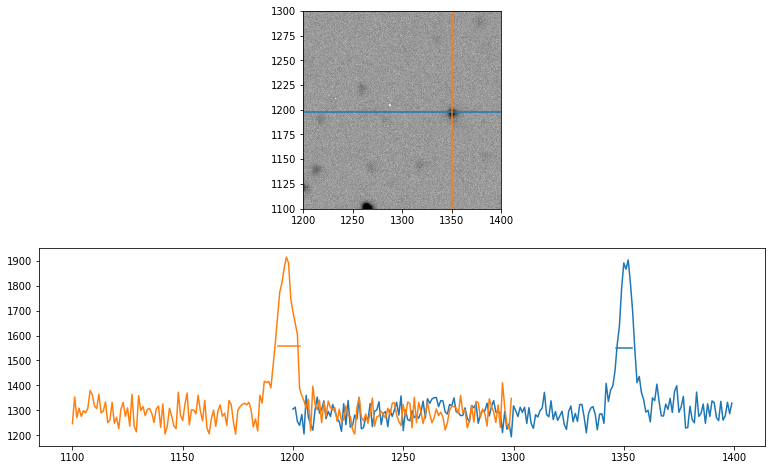

In [40]:
fig=plt.figure(figsize=(13,8))
ax1=fig.add_subplot(211)
ax1.imshow(data, cmap='Greys',vmin=np.median(data)*0.5, 
           vmax=np.median(data)*1.5)
#Use lines to identify a star's location
ax1.set_xlim(1200,1400)
ax1.set_ylim(1100,1300)
xstar=1350
ystar=1198
ax1.plot([0,1500],[ystar,ystar])
ax1.plot([xstar,xstar],[0,1300])

#Now plot the data around the star to see what its shape looks like
ax2=fig.add_subplot(212)
ax2.plot(np.arange(200)+1200,data[ystar,1200:1400],color='C0')  #Horizontal direction
ax2.plot(np.arange(200)+1100,data[1100:1300,xstar],color='C1')  #Vertical direction
halfmax_h=(np.max(data[ystar,1200:1400])-np.min(data[ystar,1200:1400]))/2.+np.min(data[ystar,1200:1400]) #Find Half Maximum value, horizontal
halfmax_v=(np.max(data[1100:1300,xstar])-np.min(data[1100:1300,xstar]))/2.+np.min(data[1100:1300,xstar]) #Find Half Maximum value, vertical
print('halfmax_h:', halfmax_h, 'halfmax_v:', halfmax_v)
#FWHM_h=   #Try different values of FWHM
#FWHM_v=  #Try different values of FWHM
ax2.plot([xstar-FWHM_h/2.,xstar+FWHM_h/2.],[halfmax_h,halfmax_h],color='C0')
ax2.plot([ystar-FWHM_v/2.,ystar+FWHM_v/2.],[halfmax_v,halfmax_v],color='C1')
#Based on these two widths, it looks like the FWHM is around X pixels *You will find X!*

Create apertures with r=FWHM and background apertures that go from 2.5-4 x FWHM.  For now, I've put in a placeholder of FWHM=10.  *You will need to replace this FWHM with an appropriate value.*

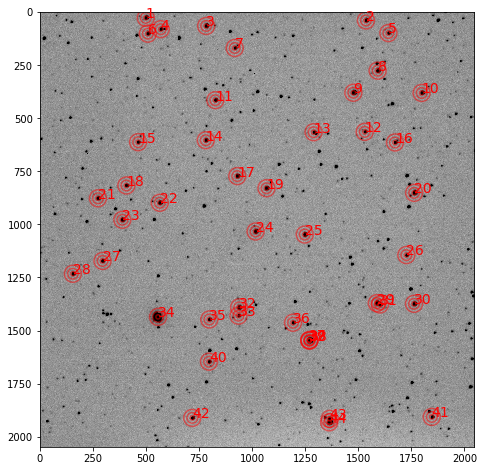

In [41]:
FWHM=10
#Create apertures and plot at positions
positions = np.transpose((sources['xcentroid'], sources['ycentroid']))
apertures = CircularAperture(positions, r=FWHM)
annulus_apertures = CircularAnnulus(positions, r_in=2.5*FWHM, r_out=4*FWHM)
fig=plt.figure(figsize=(13,8))
ax1=fig.add_subplot(111)
ax1.imshow(data, cmap='Greys',vmin=np.median(data)*0.5, 
           vmax=np.median(data)*1.5)
for mysource in sources:
    ax1.text(mysource['xcentroid'], mysource['ycentroid'], mysource['id'],color='red',fontsize=14)
apertures.plot(color='red', lw=1.5, alpha=0.5)
annulus_apertures.plot(color='red', lw=1.5, alpha=0.5)

## Use defined apertures to perform aperture photometry on all images

*Make sure to replace this FWHM with the actual FWHM.*

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


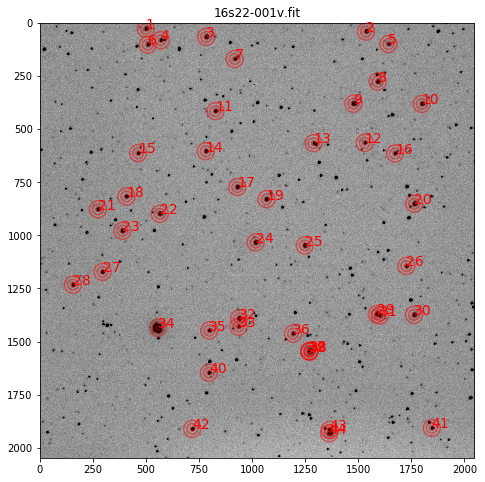

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


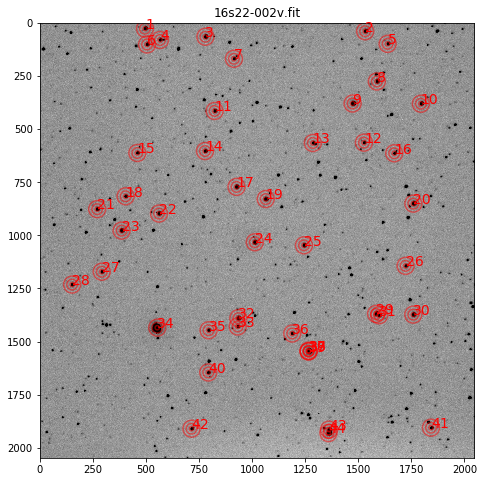

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


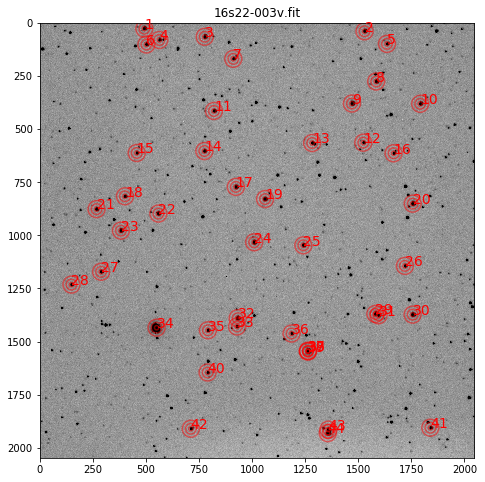

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


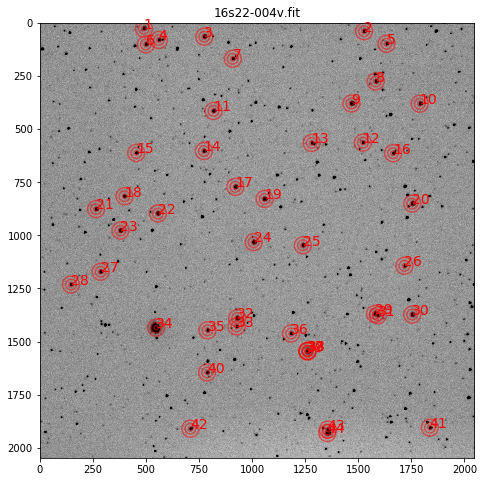

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


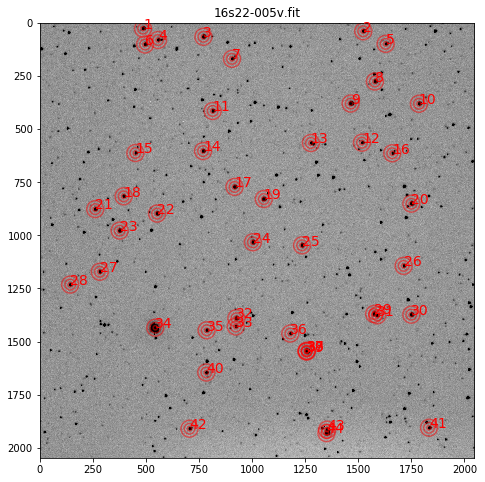

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


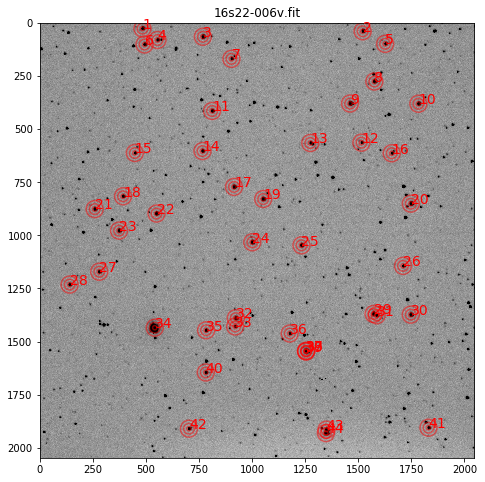

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


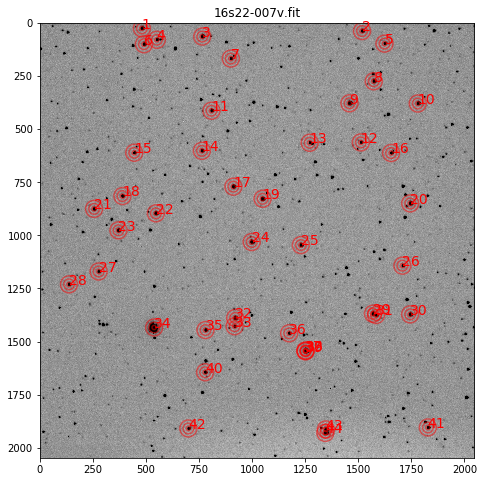

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


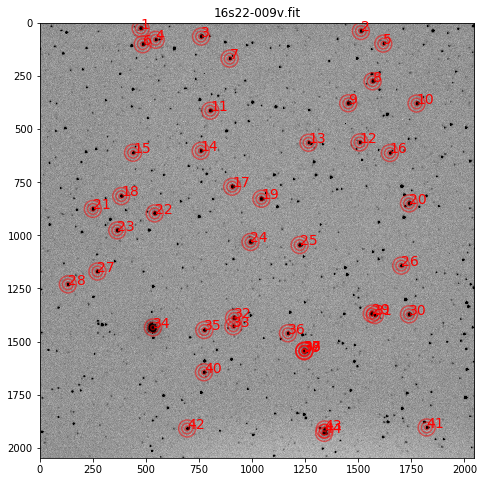

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


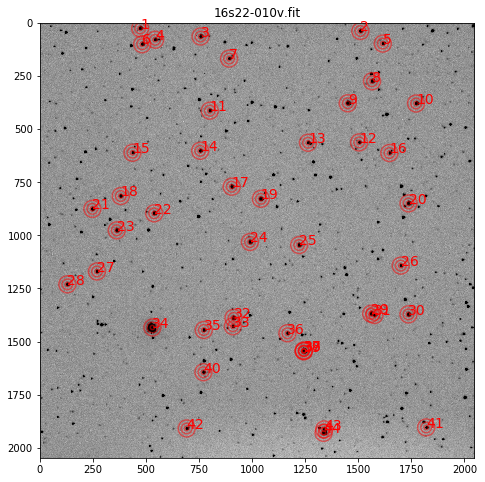

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


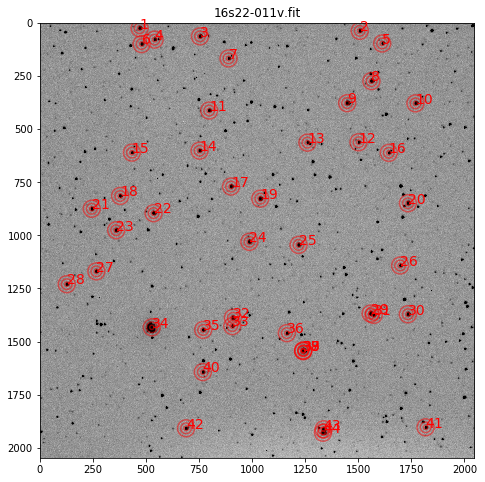

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


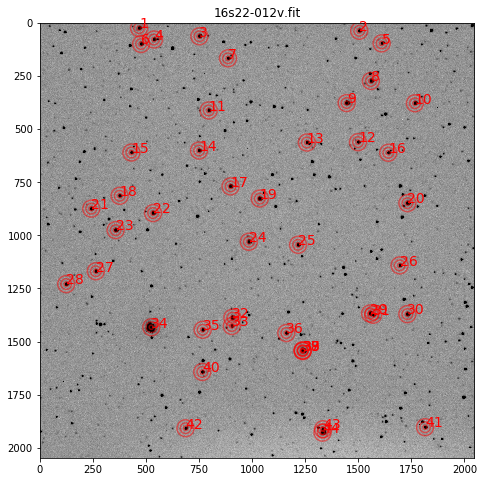

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


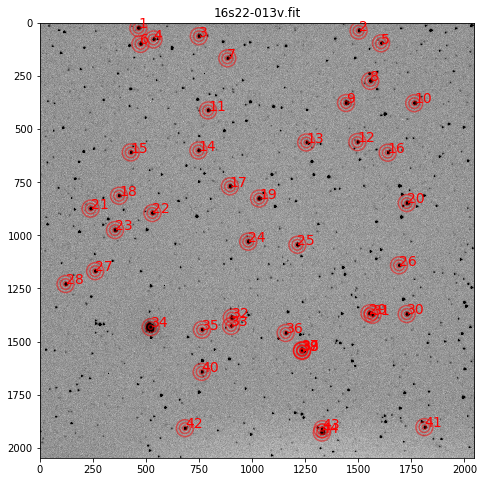

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


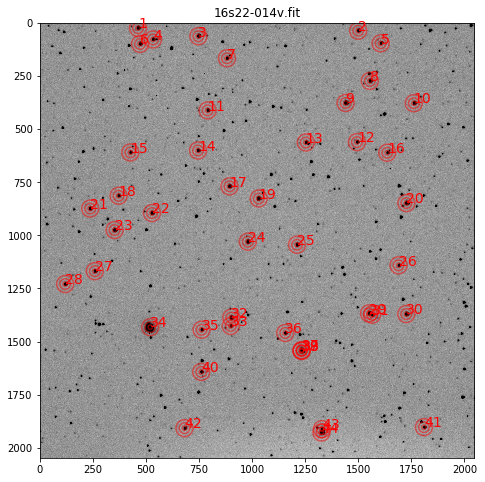

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


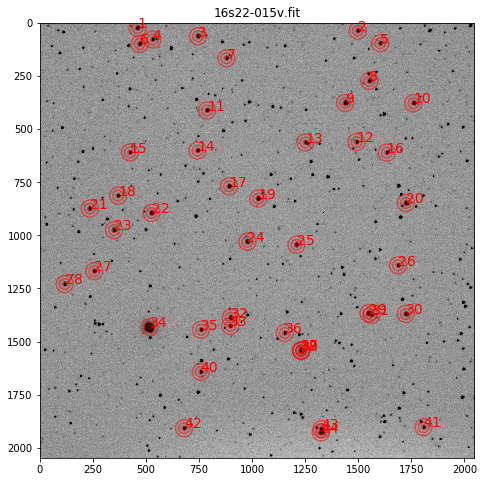

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


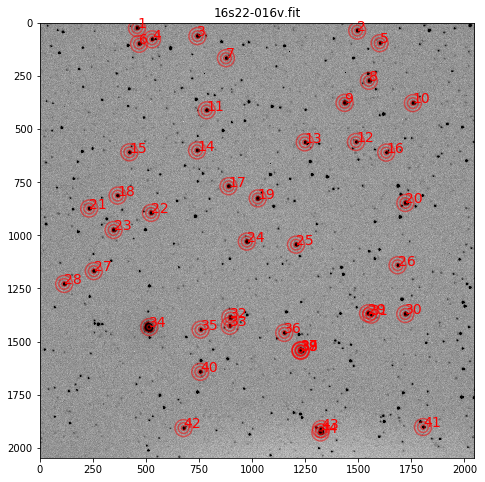

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


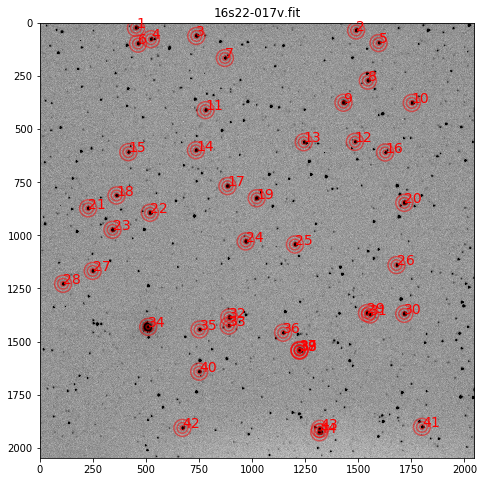

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


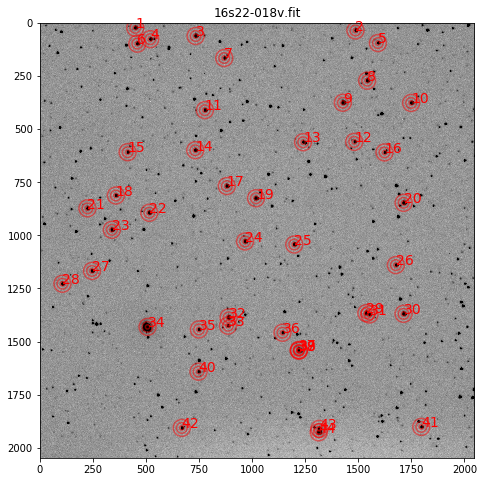

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


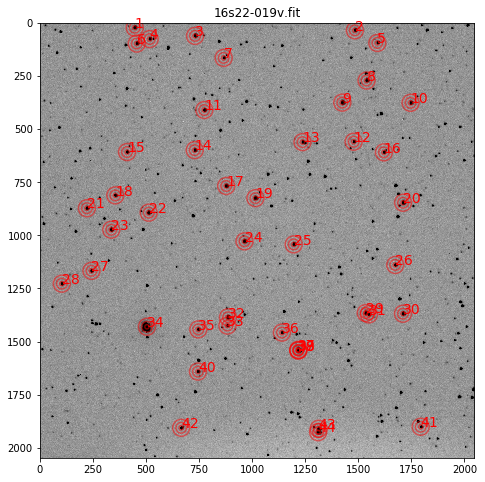

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


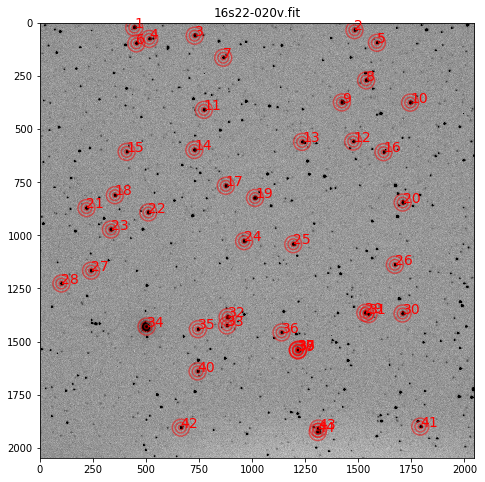

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


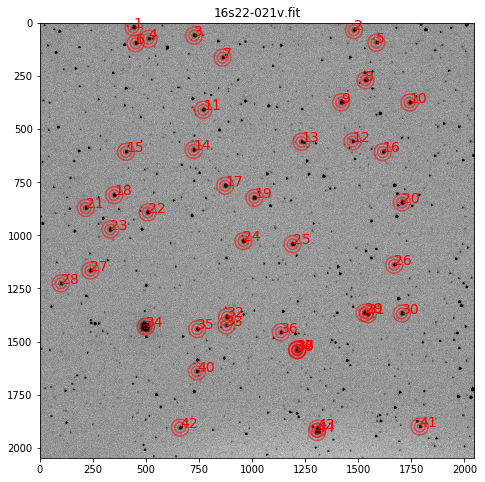

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


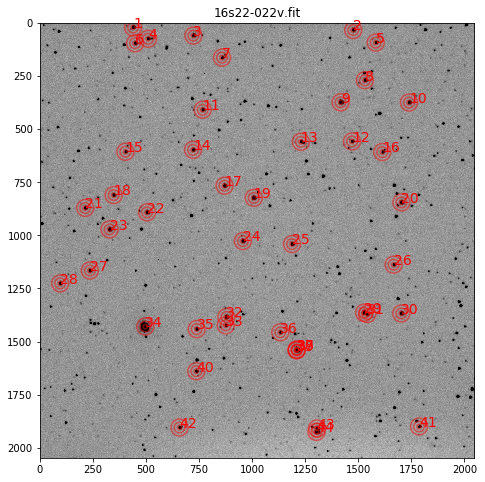

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


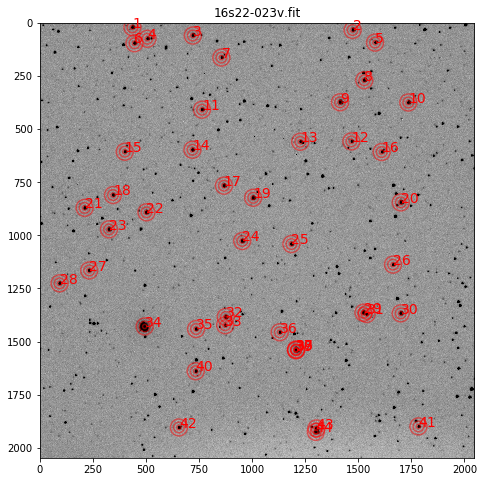

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


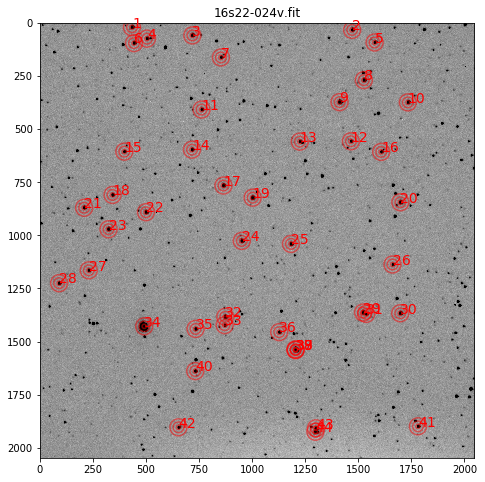

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


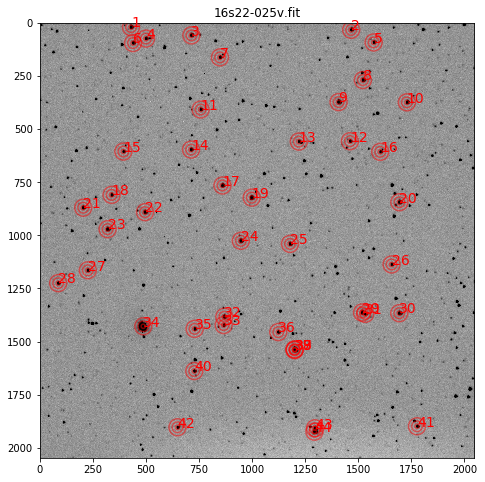

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


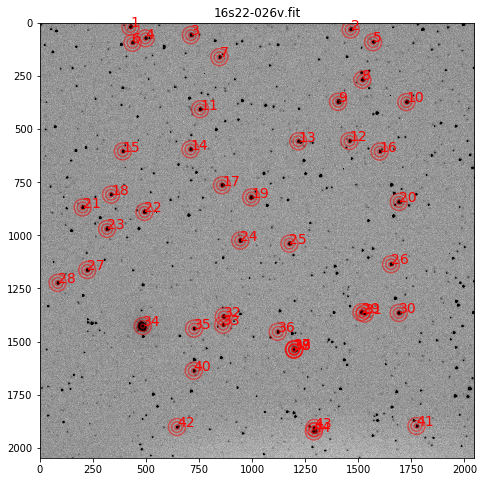

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


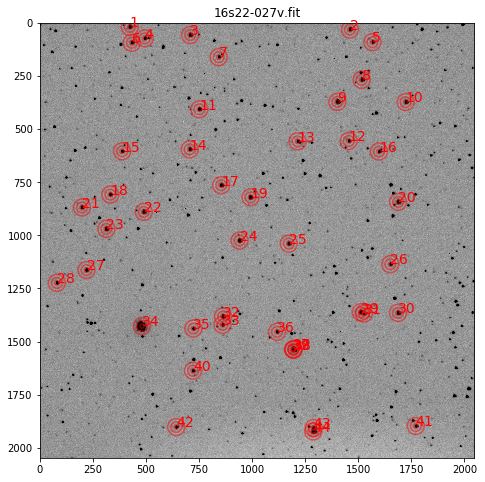

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


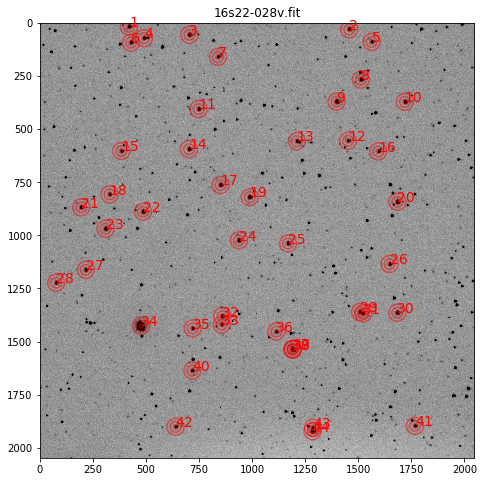

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


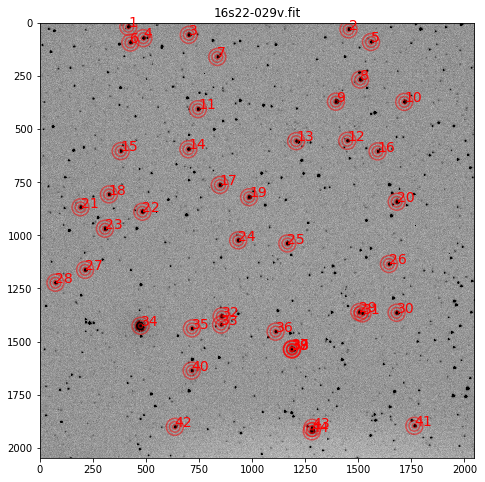

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


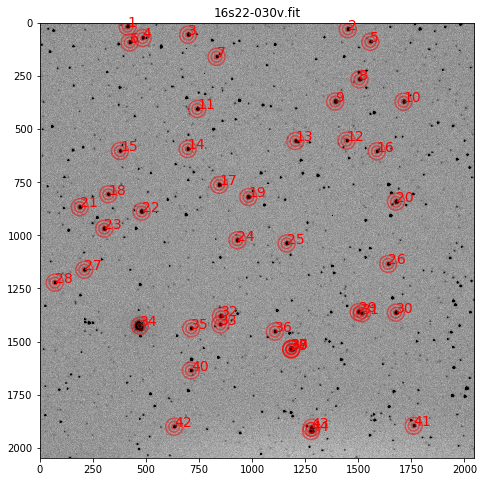

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


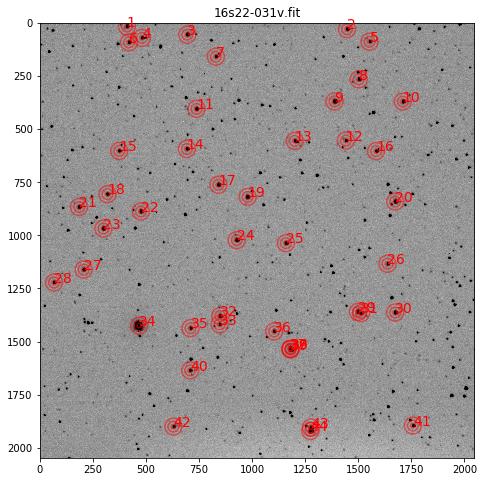

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


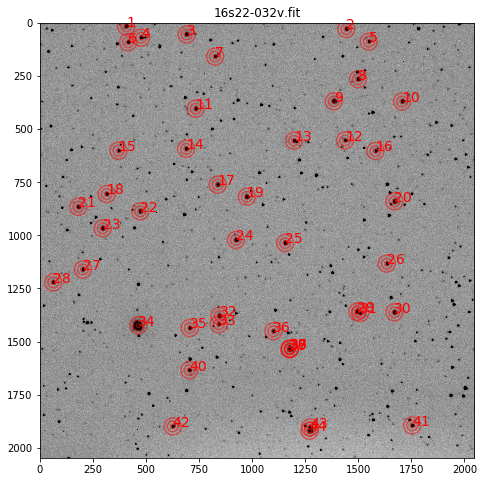

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


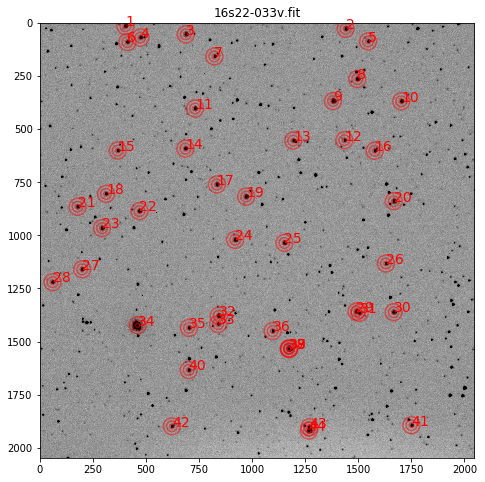

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


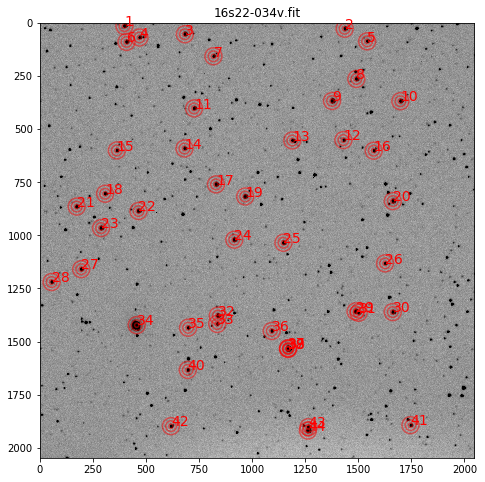

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


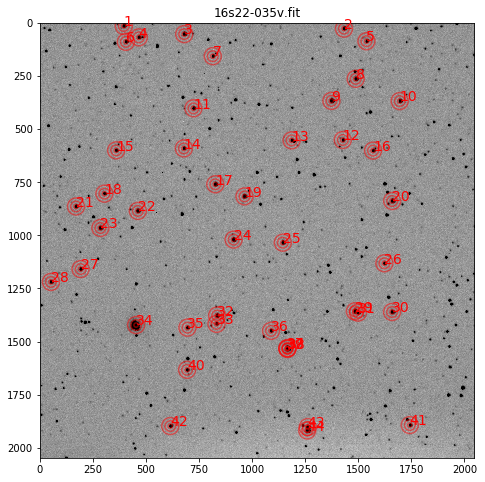

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


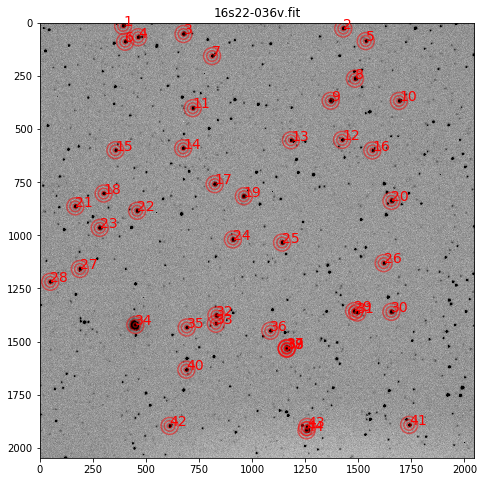

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


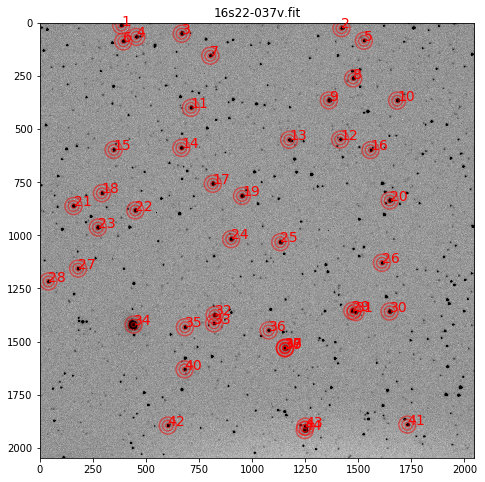

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


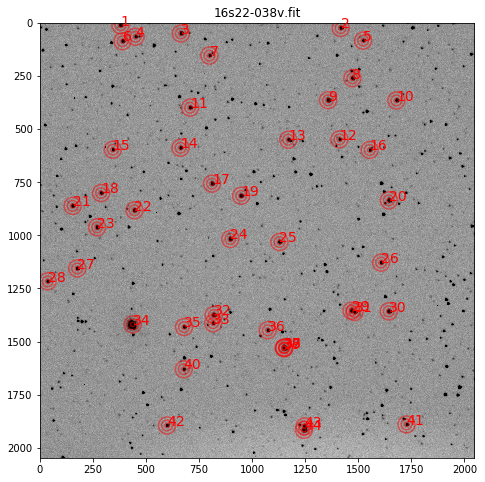

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


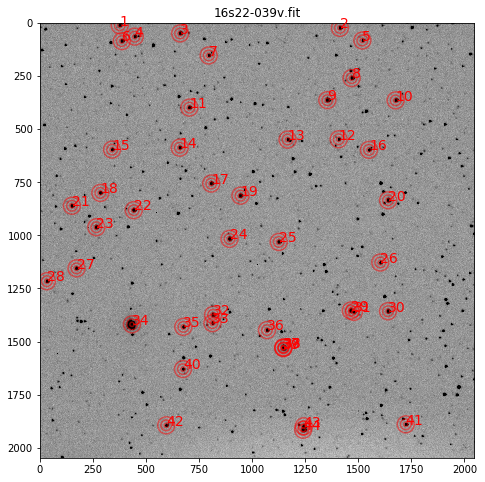

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


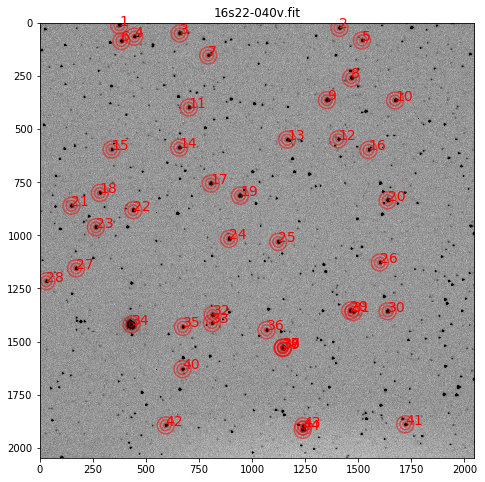

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


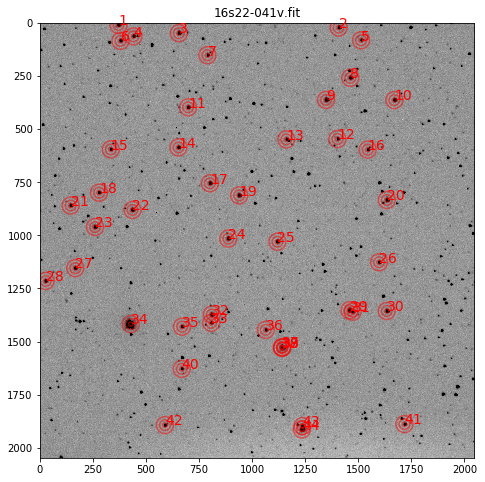

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


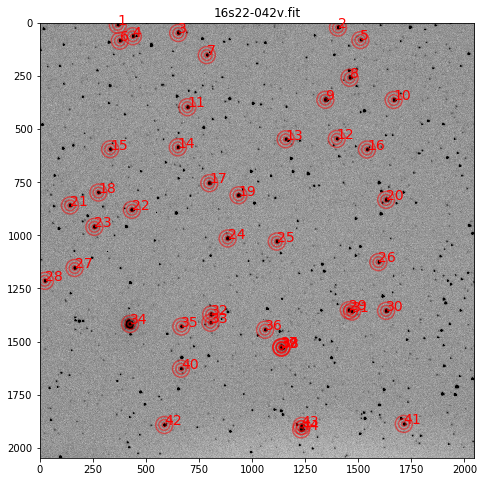

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


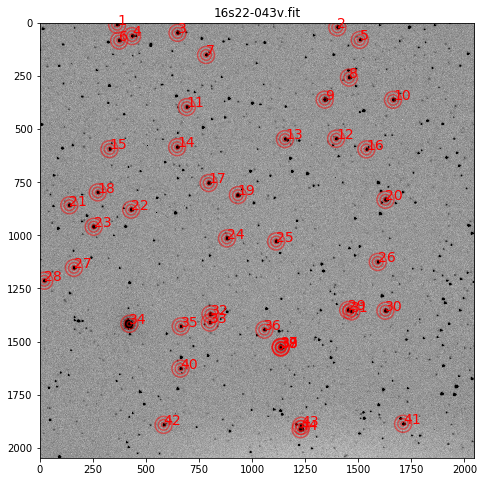

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


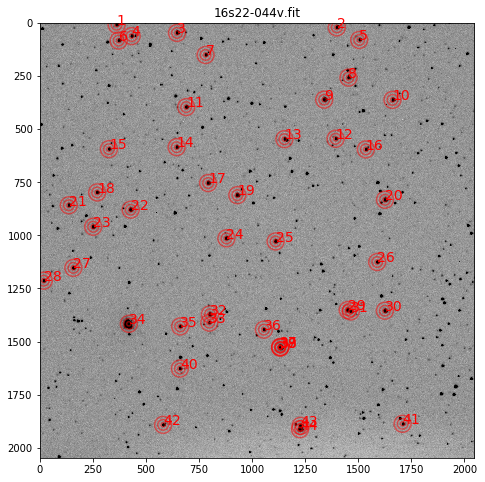

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


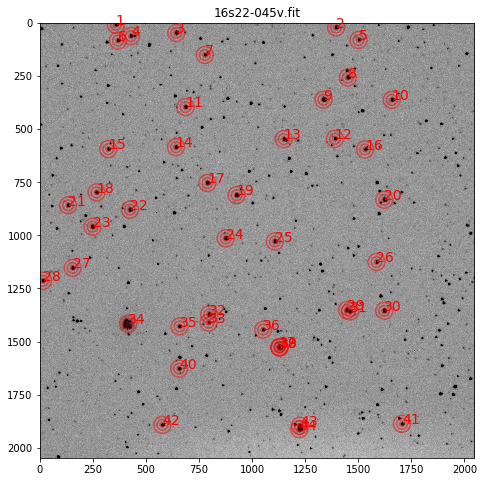

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


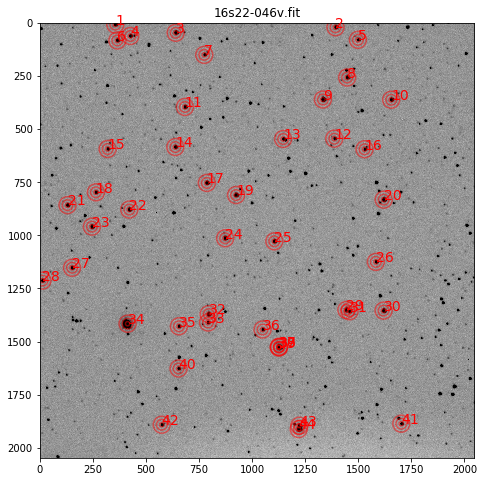

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


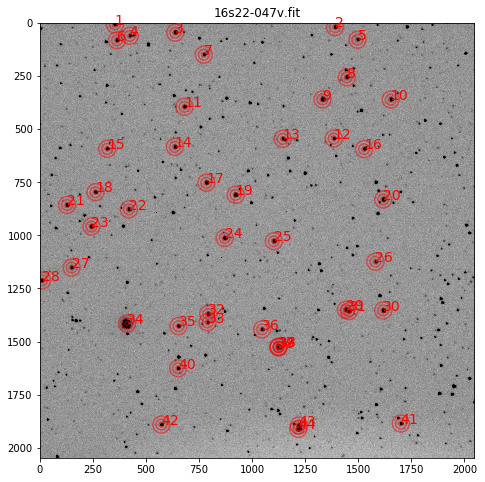

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


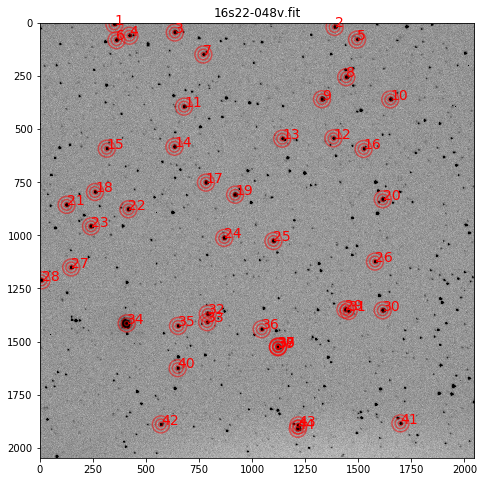

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


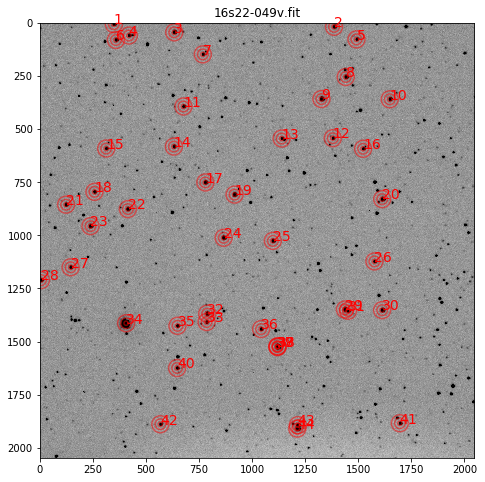

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


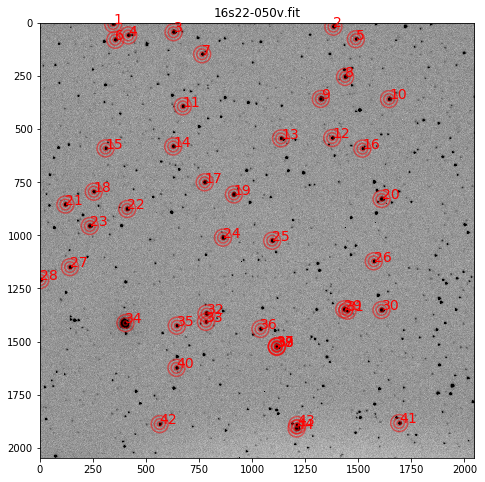

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


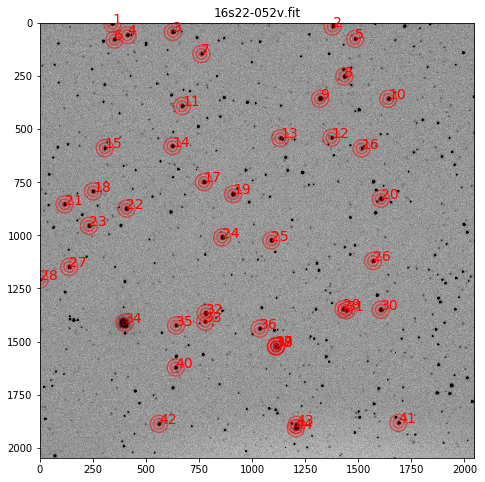

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


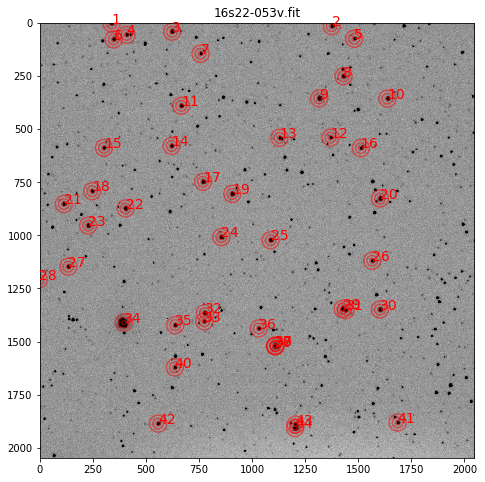

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


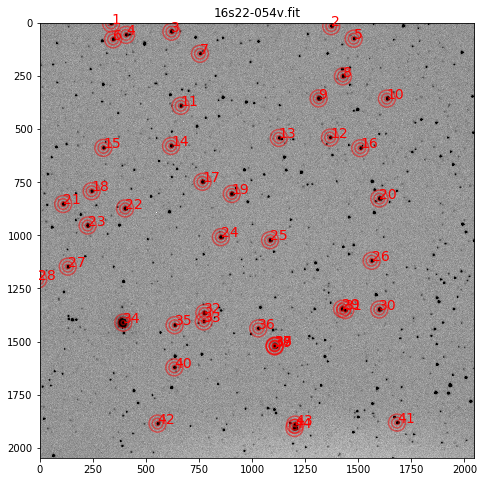

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


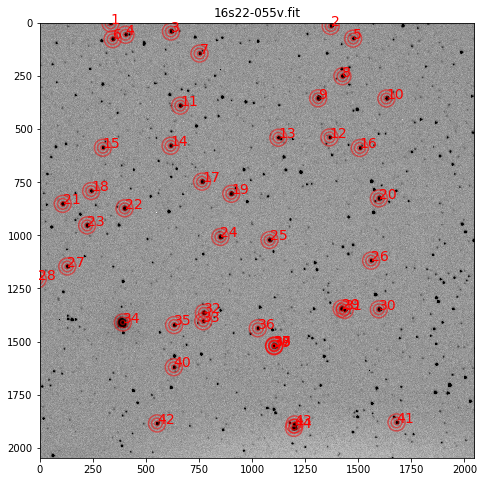

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


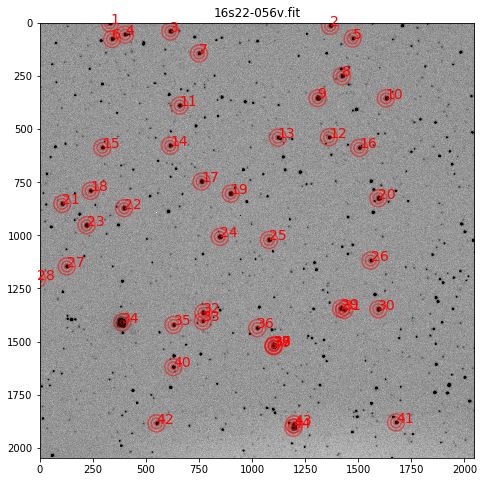

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


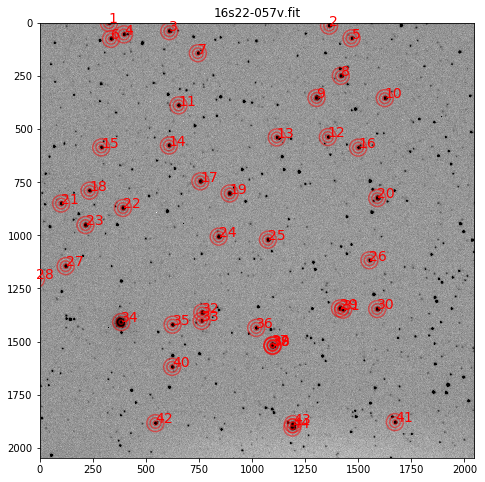

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


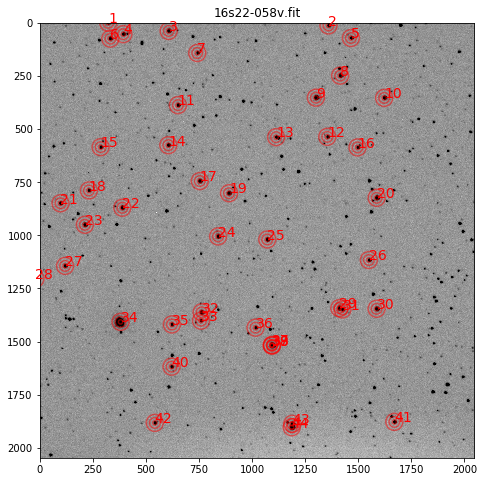

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


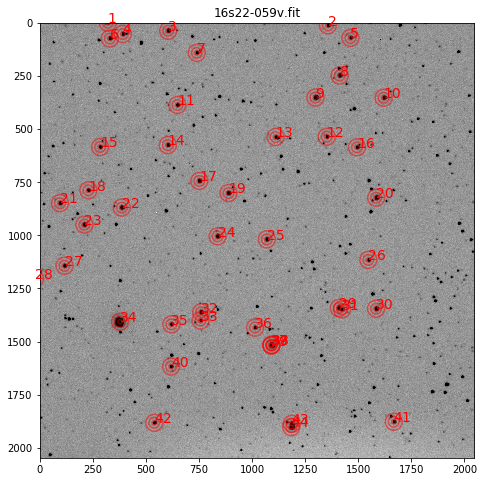

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


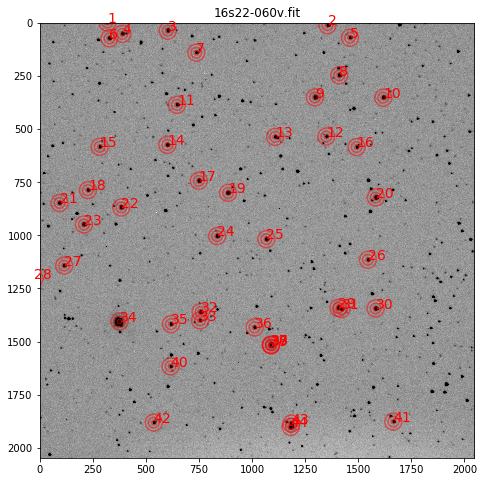

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


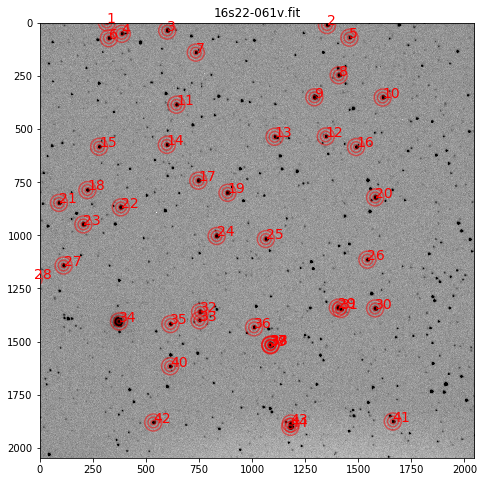

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


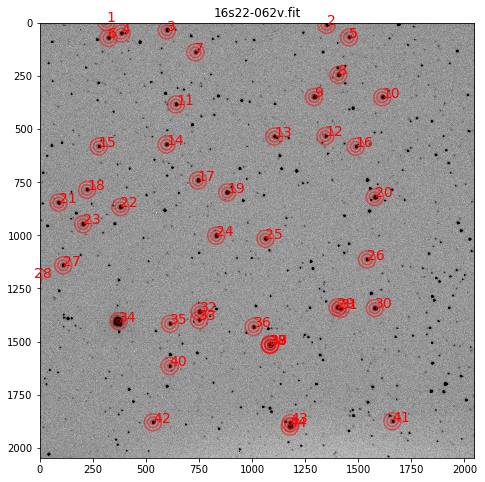

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


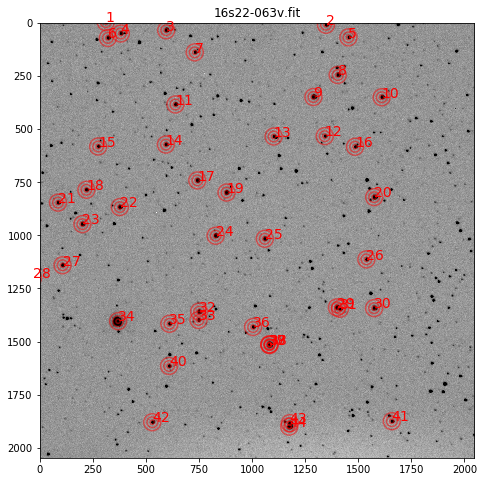

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


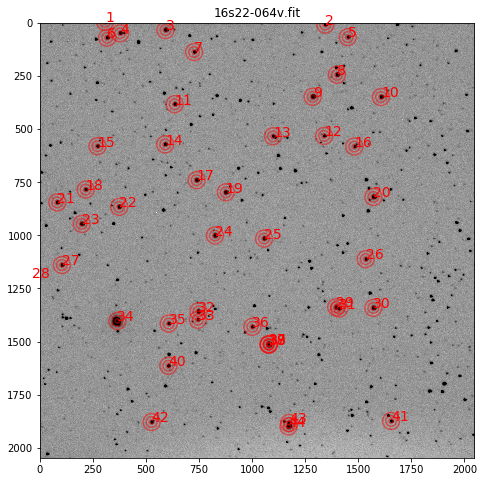

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


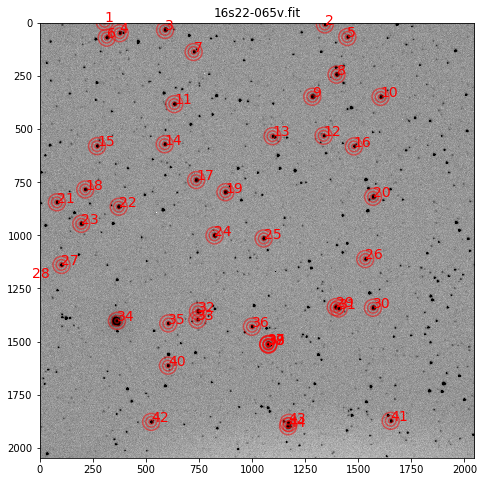

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


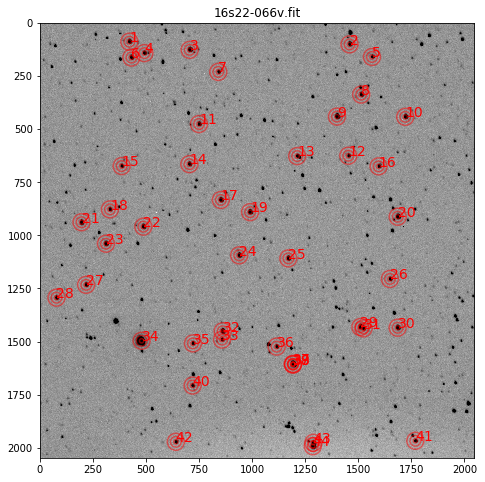

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


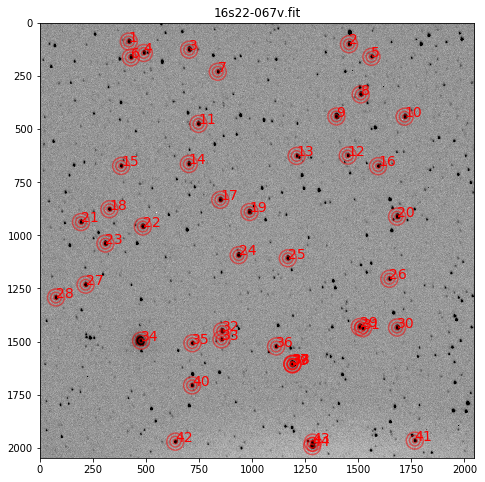

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


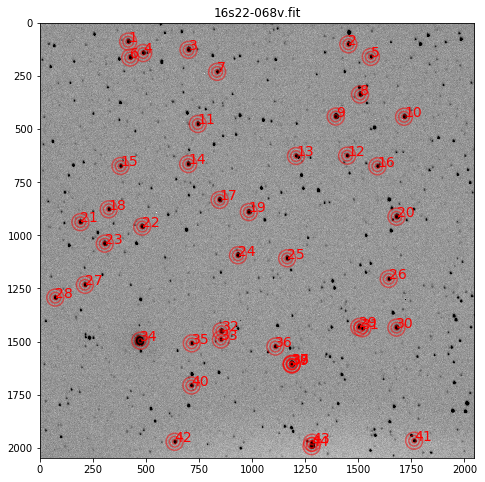

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


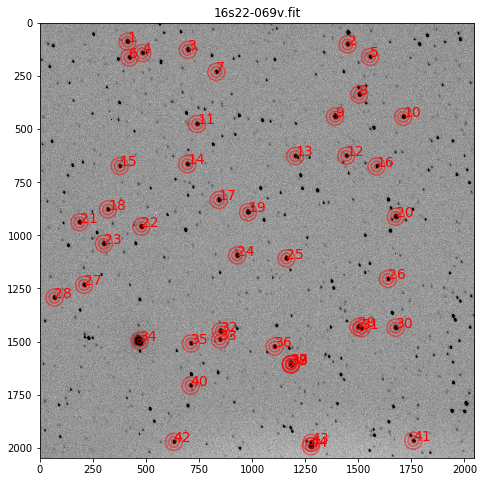

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


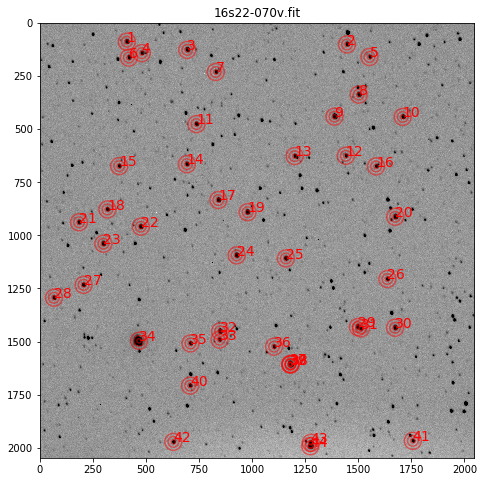

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


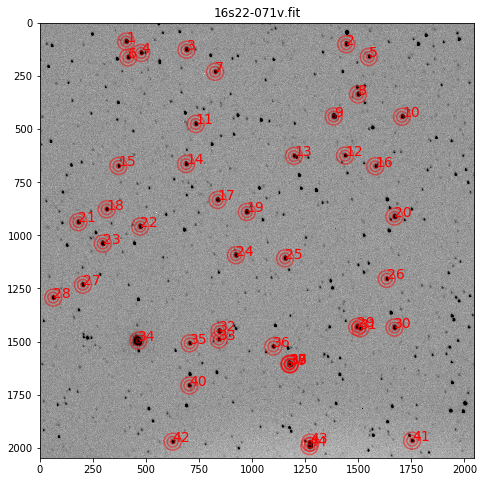

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


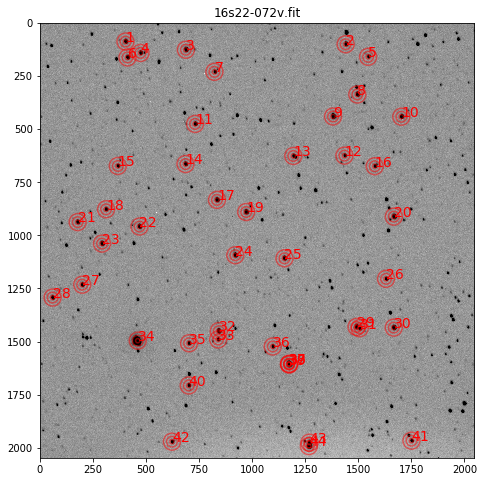

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


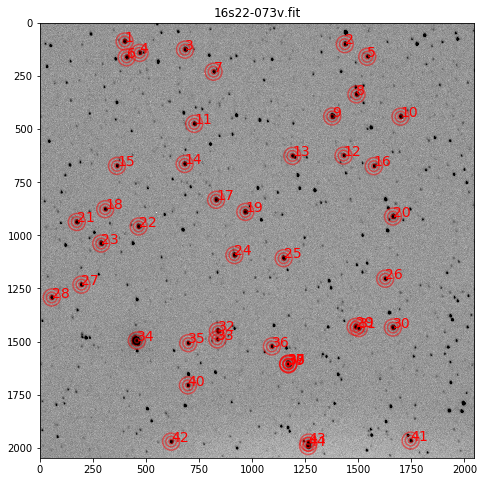

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


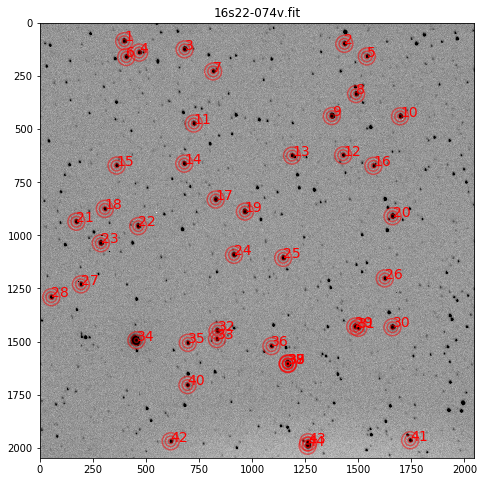

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


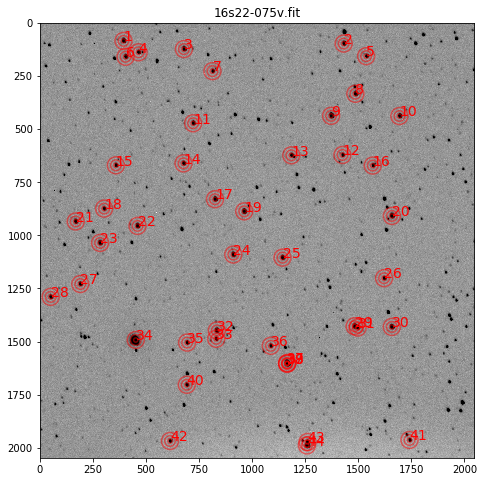

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


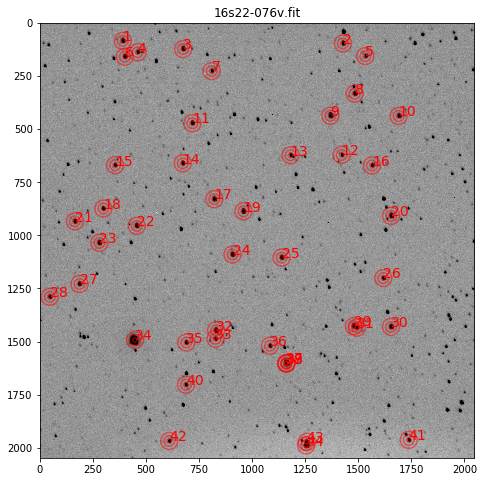

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


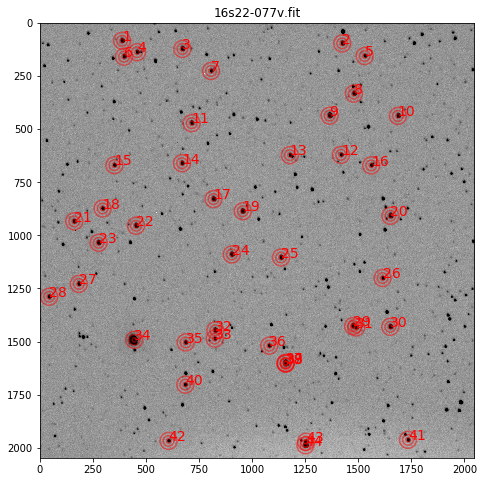

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


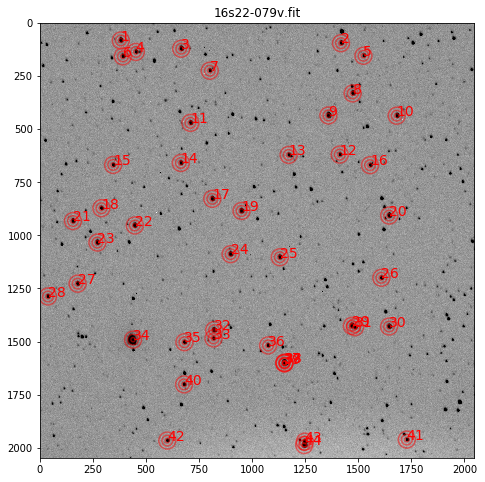

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


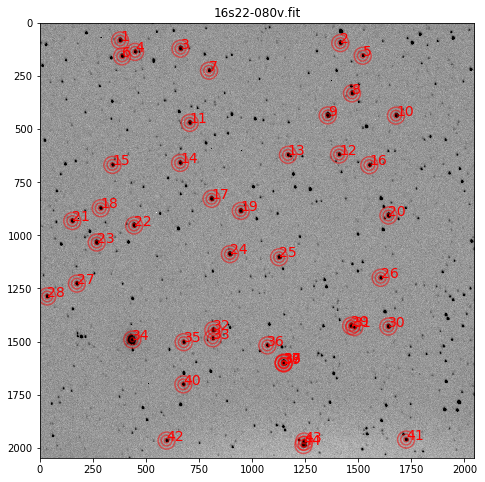

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


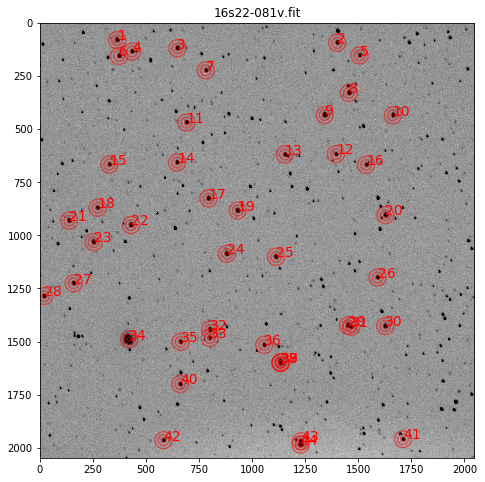

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


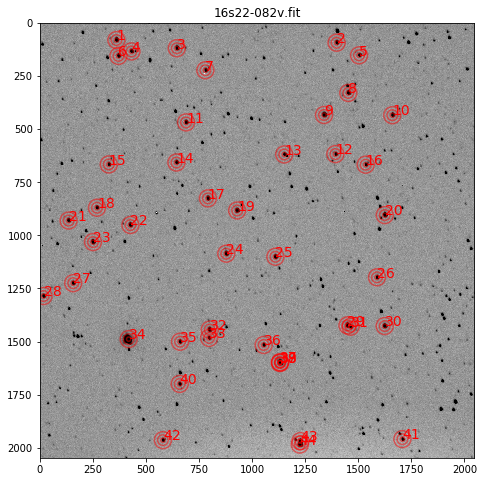

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


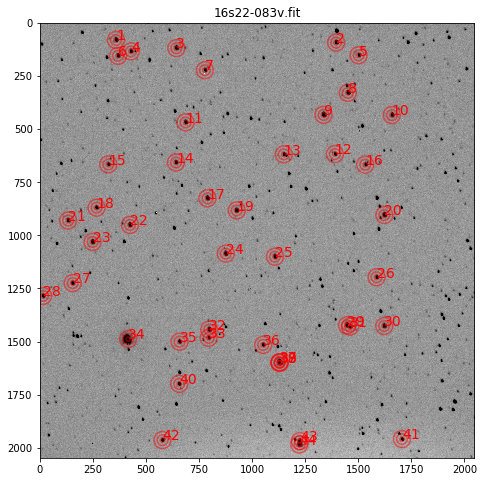

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


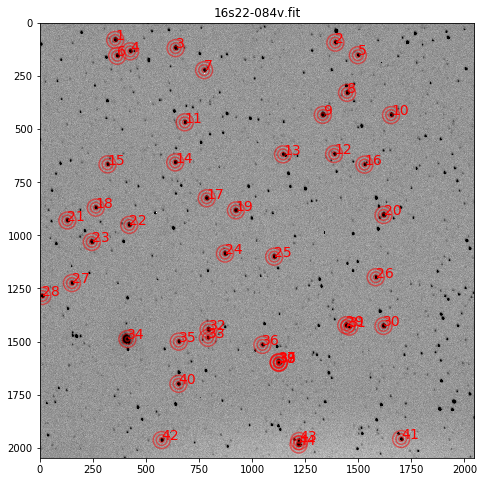

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


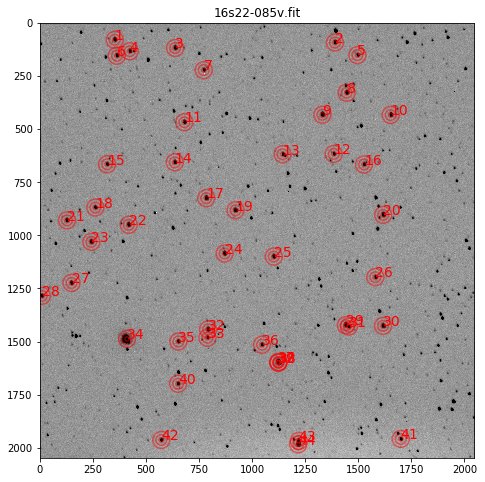

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


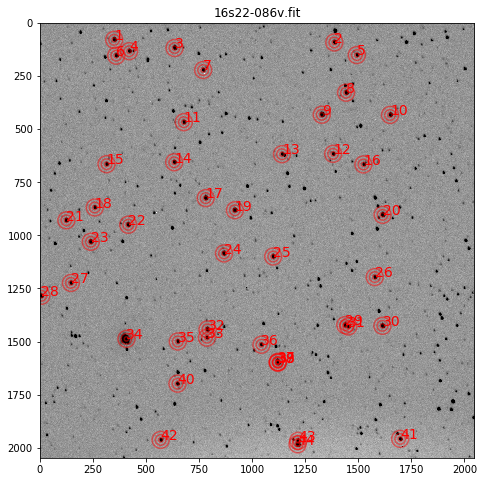

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


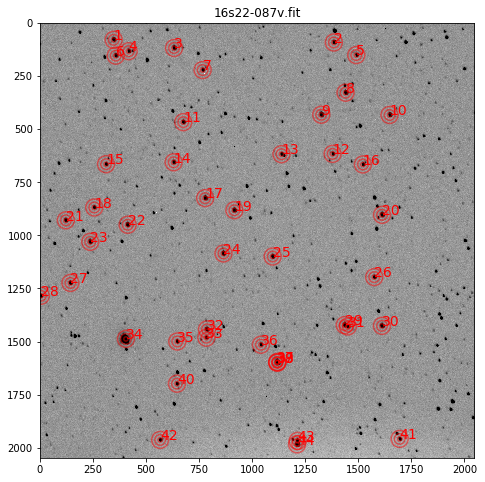

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


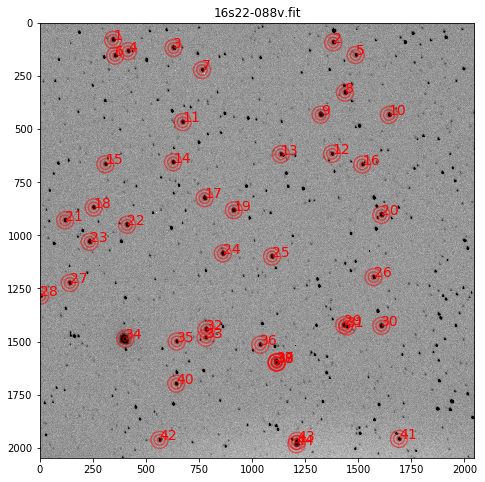

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


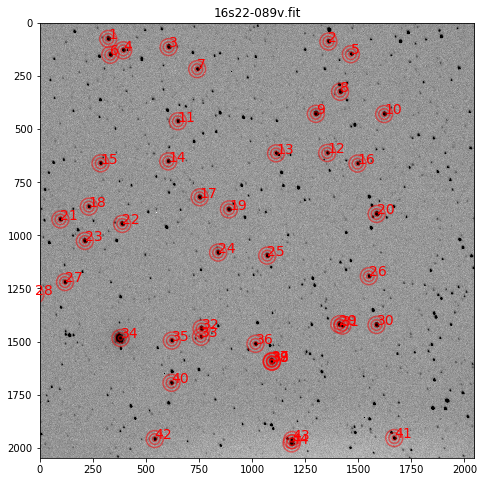

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


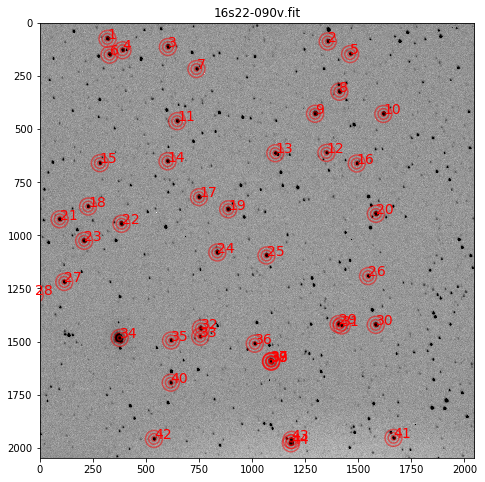

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


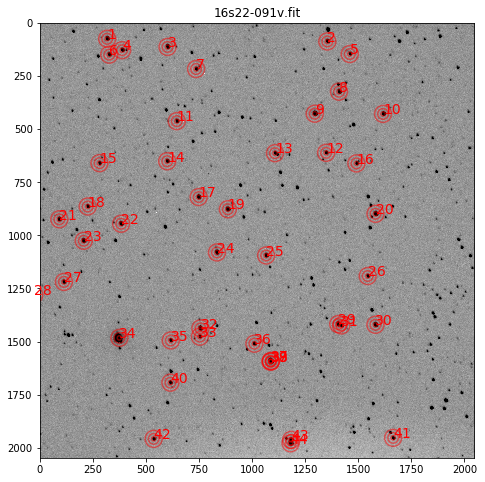

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


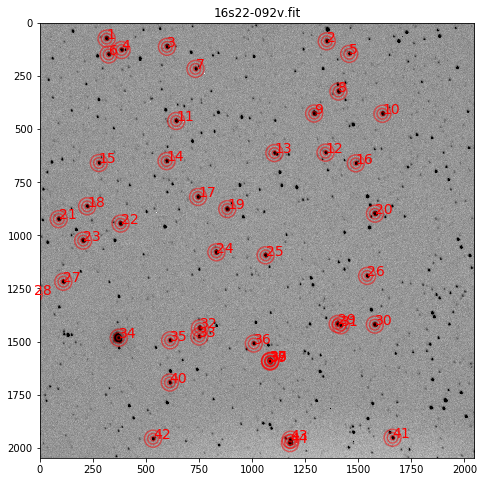

In [42]:
FWHM=10 #Replace!
#Make list of science images
science_ifc=ccdp.ImageFileCollection(reduced_dir,glob_include='*v.fit')
science_files = science_ifc.files_filtered()

#Read in image shifts
image_shifts_dict=pickle.load( open( reduced_dir+"image_shifts.p", "rb" ) )

phot_table={}
for i,myfile in enumerate(science_files):
#Read in data
    science_ccd=CCDData.read(reduced_dir+myfile, unit="adu") 
    data=science_ccd.data
#Find shift and apertures for this file
    myshift=image_shifts_dict[myfile]
    positions = np.transpose((sources['xcentroid']-myshift[1], sources['ycentroid']-myshift[0]))
    apertures = CircularAperture(positions, r=FWHM)
    annulus_apertures = CircularAnnulus(positions, r_in=2.5*FWHM, r_out=4*FWHM)
#Check that offsets are correct by replotting apertures
    fig=plt.figure(figsize=(13,8))
    ax1=fig.add_subplot(111)
    ax1.imshow(data, cmap='Greys',vmin=np.median(data)*0.5, 
               vmax=np.median(data)*1.5)
    ax1.set_title(myfile)
    for i,mysource in enumerate(sources):
        ax1.text(positions[i][0], positions[i][1], mysource['id'],color='red',fontsize=14)
    apertures.plot(color='red', lw=1.5, alpha=0.5)
    annulus_apertures.plot(color='red', lw=1.5, alpha=0.5)
    plt.show()
#Perform aperture photometry
    my_phot_table = aperture_photometry(data, [apertures, annulus_apertures])
#Add aperture photometry results to phot_table dictionary
    phot_table[myfile]=my_phot_table

#Save phot_table to pickle file
pickle.dump(phot_table, open(reduced_dir+"phot_table.p", "wb" ))  #Write phot_table to file

## Take aperture photometry results and compile to a single table for plotting

In [50]:
#Make list of science images
science_ifc=ccdp.ImageFileCollection(reduced_dir,glob_include='*v.fit')
science_files = science_ifc.files_filtered()
nimages=np.size(science_files)

#Read in photometry table
phot_table_dict=pickle.load( open( reduced_dir+"phot_table.p", "rb" ) )
nstars=np.size(phot_table_dict['16s22-001v.fit']['id'])

#Construct first row of table to hold column names
columns=['Time']
for i in np.arange(nstars):
    columns.append(str(i+1))

phot_table_all=[]

annulus_area=annulus_apertures.area()
circular_area=apertures.area()
#Loop through each key in phot_table
for i,myfile in enumerate(science_files):
#For each key, find time of observation from header
    science_ccd=CCDData.read(reduced_dir+myfile, unit="adu") 
    time=Time(science_ccd.header['DATE-OBS'], format='isot', scale='utc').mjd
    bkg_mean = phot_table[myfile]['aperture_sum_1'] / annulus_area  #Calculate mean background
    bkg_sum = bkg_mean * circular_area  #Calculate total background in circular aperture
    phot = phot_table[myfile]['aperture_sum_0'] - bkg_sum #Calculate science - background total in aperture
    row=[time]
    for i in np.arange(nstars):
        row.append(phot[i])
    phot_table_all.append(row)

phot_table_all=pd.DataFrame(phot_table_all,columns=columns)
pickle.dump(phot_table_all,open(reduced_dir+'phot_table_all.p','wb'))

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.



INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]


## Read in data and plot

Read in data

In [51]:
phot_table_all=pickle.load(open(reduced_dir+'phot_table_all.p','rb'))

*Plot data to explore*

*Make a final plot of light curve.  To do this, you must know which source is WASP-2b.  You should divide the counts from WASP-2b by the sum of counts from a large number of standard stars, although you must inspect these standards to make sure none of them are variable.  If they're not, more standard stars will give you greater accuracy on your final lightcurve.*